## Group Project Report
# An Exploratory Analysis Into Diabetes
#### Group 21: Aiko Sumarno, Yoona Wang, Jerry Jin, Daniel Chou

## Introduction:

Diabetes is a chronic disease indicated by high glucose blood levels. Globally, 10% of people have diabetes, and it is within the top 10 causes of death in adults. 


The data we have used was taken from [Kaggle](https://www.kaggle.com/datasets/iammustafatz/diabetes-prediction-dataset) and it is a dataset of diabetic and non-diabetic patients' medical history. The primary source of this dataset is Electronic Health records by healthcare providers. The dataset contains the following variables: 
* gender = male / female
* age 
* hypertension = yes / no
* heart_disease = yes / no
* smoking_history = never / no info / current / former / ever / never / not current
* bmi = body mass index
* HbA1c_level = Hemoglobin A1C level
* blood_glucose_level = amount of glucose in the blood
* diabetes = diabetic / non-diabetic


Through our project, we aim to find the relationship between the variables and  being diabetic. **How accurately can we predict the likelihood of someone having diabetes based on age, BMI, HbA1C level, and blood glucose level?**


## Methods & Results:

### Preliminary Exploratory Data Analysis:

In [1]:
# install.packages("themis")

In [2]:
library(repr)
library(tidyverse)
library(tidymodels)
library(ggplot2)
library(themis)

options(repr.matrix.max.rows = 10)

Warning message:
“package ‘ggplot2’ was built under R version 4.3.2”
── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.3     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.0
✔ ggplot2   3.5.0     ✔ tibble    3.2.1
✔ lubridate 1.9.2     ✔ tidyr     1.3.0
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
── Attaching packages ────────────────────────────────────── tidymodels 1.1.1 ──

✔ broom        1.0.5     ✔ rsample      1.2.0
✔ dials        1.2.0     ✔ tune         1.1.2
✔ infer        1.0.5     ✔ workflows    1.1.3
✔ modeldata    1.2.0     ✔ workflowsets 1.0.1
✔ parsnip      1.1.1     ✔ yardstick    1.2.0
✔ recipes      1.0.8     

── Conflicts ───────────────────────────────────────── tidymodels_co

### 1. Read and Tidy Data

For our analysis, we will use the **age**, **bmi**, **HbA1c_level**, **blood_glucose_level** and **diabetes** variables only. 

In [3]:
#diabetes <- read_csv("data/diabetes.csv")
# to demonstrate that the dataset is readable from web to R
# Our first step is to download the dataset from Kaggle since we couldn't access the raw data
# Then, we uploaded it to Github repostitory to access the raw data
# Eventually, using read_csv to access the raw data
diabetes <- read_csv("https://raw.githubusercontent.com/aikosumarno/dsci-100-2023w2-group-21/main/data/diabetes.csv")
head(diabetes)

Rows: 100000 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr (2): gender, smoking_history
dbl (7): age, hypertension, heart_disease, bmi, HbA1c_level, blood_glucose_l...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
Female,80,0,1,never,25.19,6.6,140,0
Female,54,0,0,No Info,27.32,6.6,80,0
Male,28,0,0,never,27.32,5.7,158,0
Female,36,0,0,current,23.45,5.0,155,0
Male,76,1,1,current,20.14,4.8,155,0
Female,20,0,0,never,27.32,6.6,85,0


In [4]:
diabetes <- diabetes |>
              mutate(diabetes = as_factor(diabetes)) |>
              mutate(diabetes = fct_recode(diabetes, "diabetic" = "1", "non-diabetic" = "0")) |> 
              mutate(hypertension = as_factor(hypertension)) |> 
              mutate(hypertension = fct_recode(hypertension, "yes" = "1", "no" = "0")) |> 
              mutate(heart_disease = as_factor(heart_disease)) |> 
              mutate(heart_disease = fct_recode(heart_disease, "yes" = "1", "no" = "0"))
head(diabetes)

gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
<chr>,<dbl>,<fct>,<fct>,<chr>,<dbl>,<dbl>,<dbl>,<fct>
Female,80,no,yes,never,25.19,6.6,140,non-diabetic
Female,54,no,no,No Info,27.32,6.6,80,non-diabetic
Male,28,no,no,never,27.32,5.7,158,non-diabetic
Female,36,no,no,current,23.45,5.0,155,non-diabetic
Male,76,yes,yes,current,20.14,4.8,155,non-diabetic
Female,20,no,no,never,27.32,6.6,85,non-diabetic


In [5]:
diabetes_tidy <- diabetes |> 
                    select(-gender, - hypertension, -heart_disease, -smoking_history)
head(diabetes_tidy)

age,bmi,HbA1c_level,blood_glucose_level,diabetes
<dbl>,<dbl>,<dbl>,<dbl>,<fct>
80,25.19,6.6,140,non-diabetic
54,27.32,6.6,80,non-diabetic
28,27.32,5.7,158,non-diabetic
36,23.45,5.0,155,non-diabetic
76,20.14,4.8,155,non-diabetic
20,27.32,6.6,85,non-diabetic


### 2. Summarize Data 

Data is split into **75% for training** and **25% for testing**.


To summarize the training data, we counted the percentage of patients diagnosed with diabetes, and calculated and compared the average value of each predictor between diabetic and non-diabetic patients. 

In [6]:
set.seed(123) ## ensures replicability
diabetes_split <- initial_split(diabetes_tidy, prop = 0.75, strata = diabetes) 
diabetes_training <- training(diabetes_split)
diabetes_testing <- testing(diabetes_split)

In [7]:
glimpse(diabetes_training)

Rows: 75,000
Columns: 5
$ age                 <dbl> 80, 76, 44, 79, 32, 54, 78, 67, 76, 78, 15, 42, 37…
$ bmi                 <dbl> 25.19, 20.14, 19.31, 23.86, 27.32, 54.70, 36.05, 2…
$ HbA1c_level         <dbl> 6.6, 4.8, 6.5, 5.7, 5.0, 6.0, 5.0, 5.8, 5.0, 6.6, …
$ blood_glucose_level <dbl> 140, 155, 200, 85, 100, 100, 130, 200, 160, 126, 2…
$ diabetes            <fct> non-diabetic, non-diabetic, diabetic, non-diabetic…


In [8]:
glimpse(diabetes_testing)

Rows: 25,000
Columns: 5
$ age                 <dbl> 54, 28, 36, 20, 42, 53, 42, 72, 4, 30, 67, 50, 34,…
$ bmi                 <dbl> 27.32, 27.32, 23.45, 27.32, 33.64, 27.32, 27.32, 2…
$ HbA1c_level         <dbl> 6.6, 5.7, 5.0, 6.6, 4.8, 6.1, 5.7, 6.5, 4.0, 6.1, …
$ blood_glucose_level <dbl> 80, 158, 155, 85, 145, 85, 80, 130, 140, 126, 200,…
$ diabetes            <fct> non-diabetic, non-diabetic, non-diabetic, non-diab…


In [9]:
cat("Table 1: Number and Percentage of Patients that Diagnosed with Diabetes\n")
diabetes_proportions <- diabetes_training |>
                          group_by(diabetes) |>
                          summarize(count = n()) |>
                          mutate(percent = 100*count/nrow(diabetes_training))

diabetes_proportions
#From Table 1, we obtained that the percentage of patients with diabete in the dataset

Table 1: Number and Percentage of Patients that Diagnosed with Diabetes


diabetes,count,percent
<fct>,<int>,<dbl>
non-diabetic,68613,91.484
diabetic,6387,8.516


In [10]:
cat("Table 2: Average Predictor Values\n")
diabetes_mean <- diabetes_training |>
                    select(-diabetes) |>
                    map_df(mean) 
diabetes_mean

Table 2: Average Predictor Values


age,bmi,HbA1c_level,blood_glucose_level
<dbl>,<dbl>,<dbl>,<dbl>
41.87175,27.30872,5.526589,138.0455


In [11]:
cat("Table 3: Average Predictor Values for Diabetic and Non-Diabetic Patients")
comparison <- diabetes_training |>
                group_by(diabetes) |>
                summarize(avg_age = mean(age),
                          avg_bmi = mean(bmi), 
                          avg_HbA1c_level = mean(HbA1c_level), 
                          avg_blood_glucose_level = mean(blood_glucose_level))
comparison

Table 3: Average Predictor Values for Diabetic and Non-Diabetic Patients

diabetes,avg_age,avg_bmi,avg_HbA1c_level,avg_blood_glucose_level
<fct>,<dbl>,<dbl>,<dbl>,<dbl>
non-diabetic,40.09991,26.87615,5.395717,132.8445
diabetic,60.90590,31.95565,6.932504,193.9172


### 3. Exploratory Data Visualization

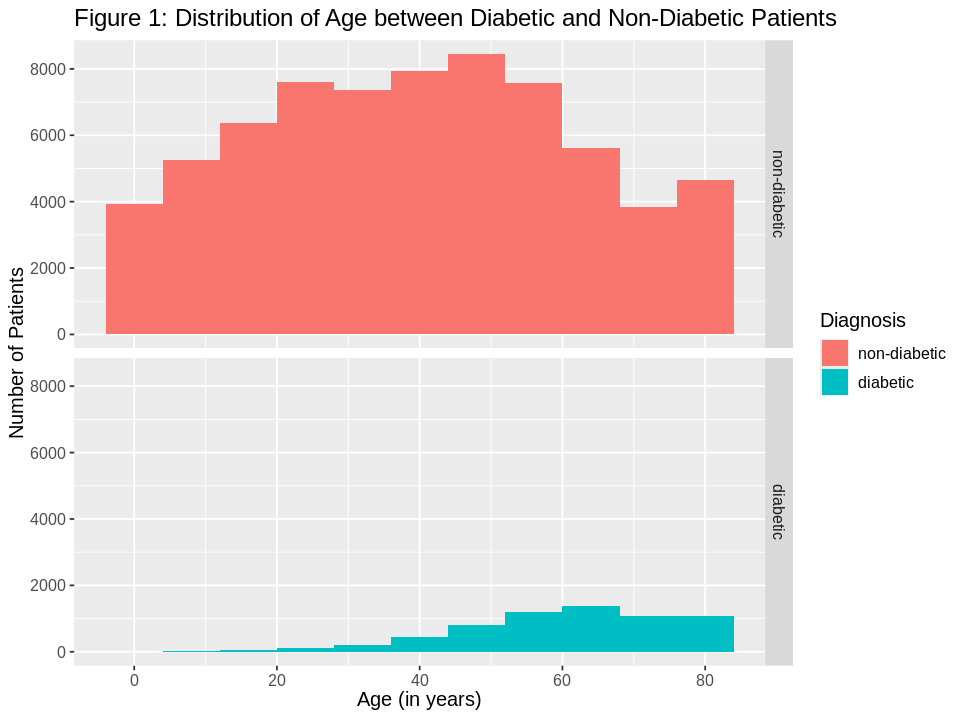

In [12]:
options(repr.plot.width = 8, repr.plot.height = 6)
age_plot <- diabetes_training |>
                ggplot(aes(x = age, fill = diabetes)) +
                geom_histogram(binwidth = 8) +
                facet_grid(rows = vars(diabetes)) +
                labs(x = "Age (in years)", y = "Number of Patients", fill = "Diagnosis") +
                ggtitle("Figure 1: Distribution of Age between Diabetic and Non-Diabetic Patients") +
                theme(text = element_text(size = 12))
age_plot

Non-diabetic patients have a consistent distribution over the age range, with a slight decrease in the oldest age group. There is an increase in diabetic patients with age.

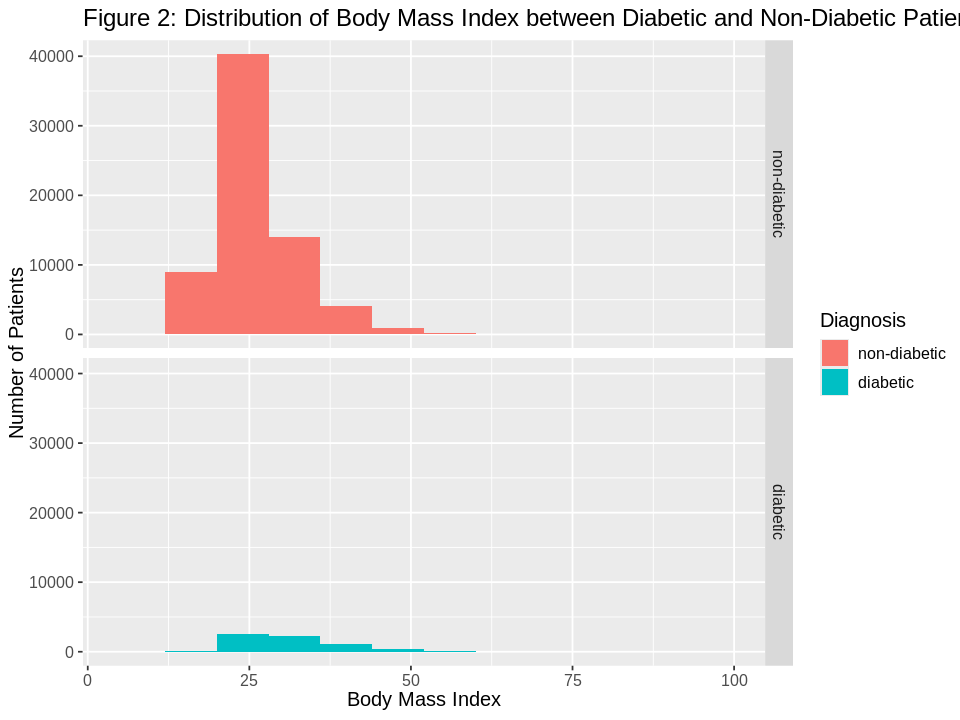

In [13]:
bmi_plot <- diabetes_training |>
                ggplot(aes(x = bmi, fill = diabetes)) +
                geom_histogram(binwidth = 8) +
                facet_grid(rows = vars(diabetes)) +
                labs(x = "Body Mass Index", y = "Number of Patients", fill = "Diagnosis") +
                ggtitle("Figure 2: Distribution of Body Mass Index between Diabetic and Non-Diabetic Patients") +
                theme(text = element_text(size = 12))
bmi_plot

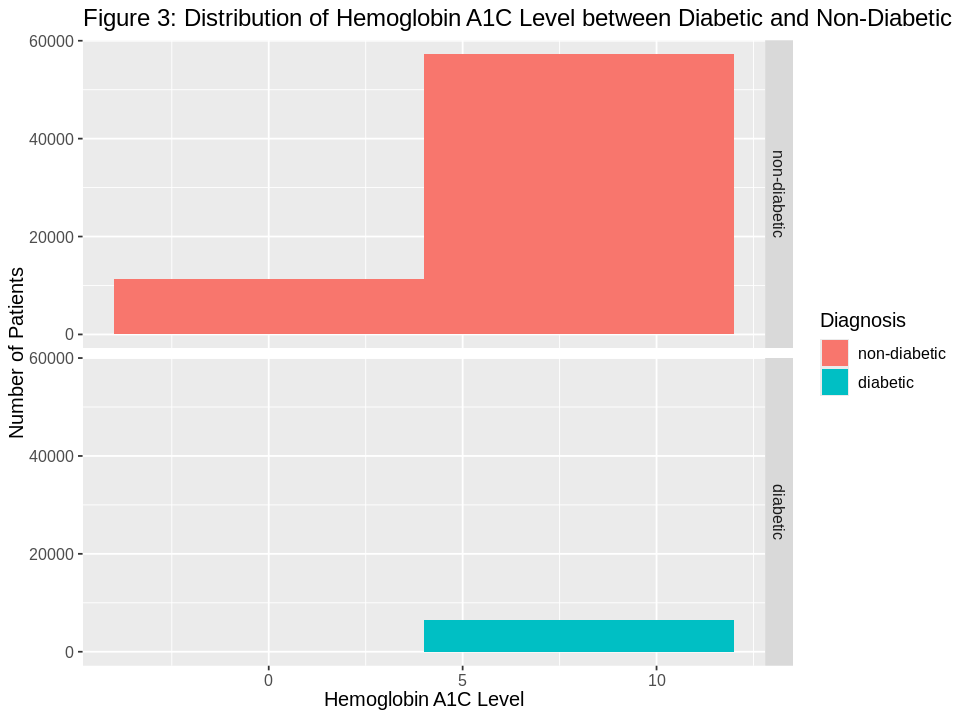

In [14]:
HbA1c_level_plot <- diabetes_training |>
                        ggplot(aes(x = HbA1c_level, fill = diabetes)) +
                        geom_histogram(binwidth = 8) +
                        facet_grid(rows = vars(diabetes)) +
                        labs(x = "Hemoglobin A1C Level", y = "Number of Patients", fill = "Diagnosis") +
                        ggtitle("Figure 3: Distribution of Hemoglobin A1C Level between Diabetic and Non-Diabetic Patients") +
                        theme(text = element_text(size = 12))
HbA1c_level_plot

Diabetics have haemoglobin A1C levels of ~4% or higher. 

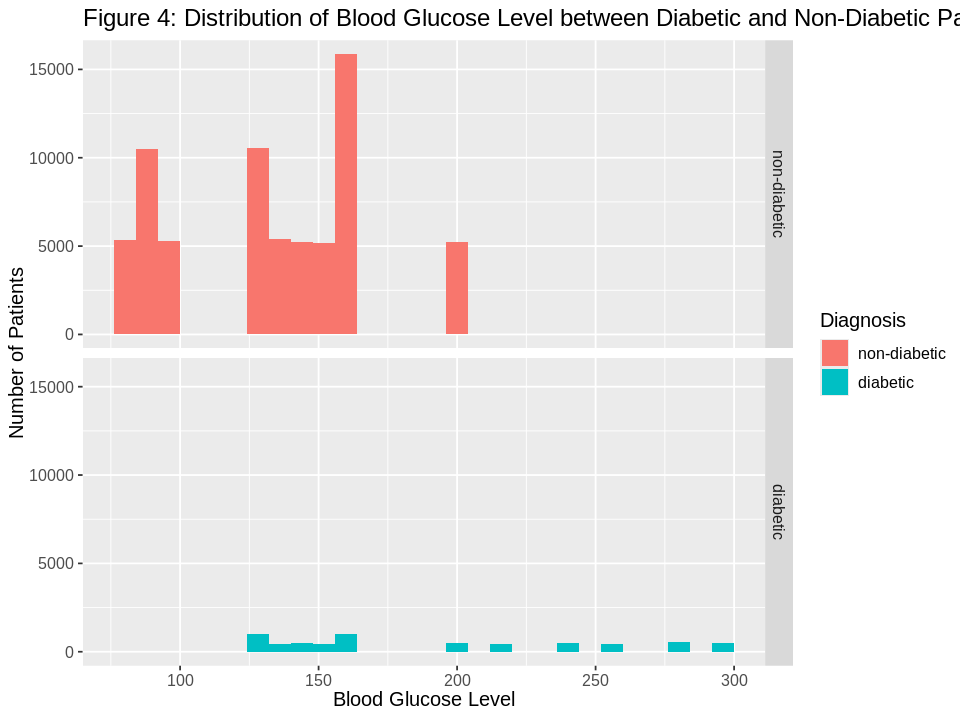

In [15]:
blood_glucose_level_plot <- diabetes_training |>
                            ggplot(aes(x = blood_glucose_level, fill = diabetes)) +
                            geom_histogram(binwidth = 8) +
                            facet_grid(rows = vars(diabetes)) +
                            labs(x = "Blood Glucose Level", y = "Number of Patients", fill = "Diagnosis") +
                            ggtitle("Figure 4: Distribution of Blood Glucose Level between Diabetic and Non-Diabetic Patients") +
                            theme(text = element_text(size = 12))
blood_glucose_level_plot

Non-diabetic patients' blood glucose levels are concentrated at lower levels, while diabetic patients have a greater distribution with many spikes, implying that they experience a wider range of blood glucose levels, including highly elevated levels.

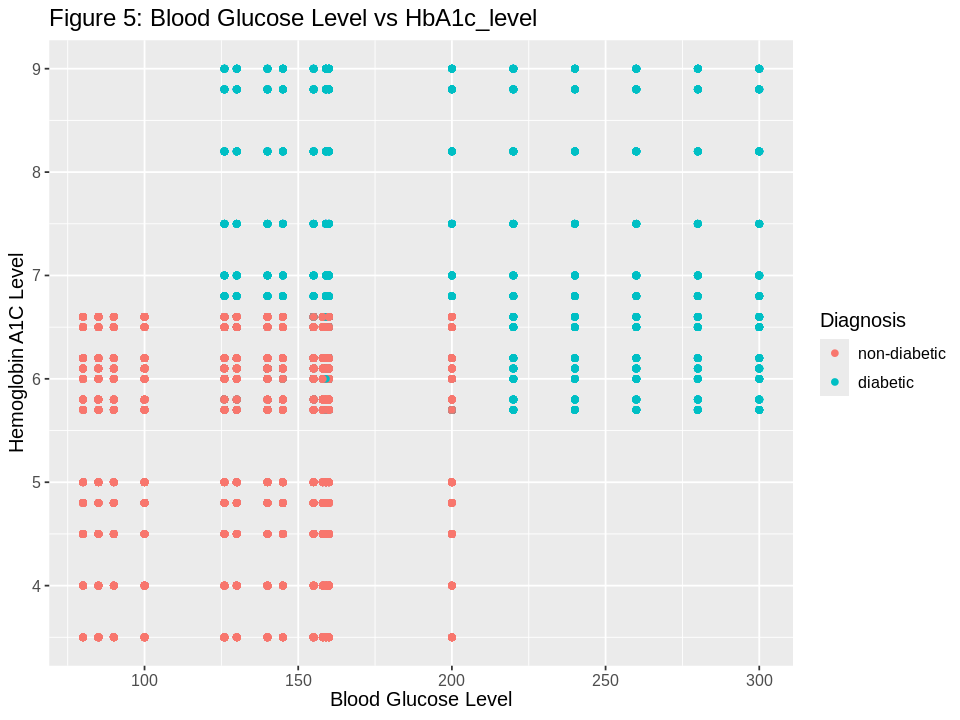

In [16]:
blood_vs_HbA1c_plot <- diabetes_training |>
                            ggplot(aes(x = blood_glucose_level, y = HbA1c_level, color = diabetes)) +
                            geom_point() +
                            labs(x = "Blood Glucose Level", y = "Hemoglobin A1C Level", color = "Diagnosis") +
                            ggtitle("Figure 5: Blood Glucose Level vs HbA1c_level") +
                            theme(text = element_text(size = 12))
blood_vs_HbA1c_plot

The clusters indicate a clear distinction between non-diabetic and diabetic patients. There's a higher chance of being diabetic if an individual has a high blood_glucose_level, HbA1c_level, or both. 

### Methods:

We will use KNN classification to predict a categorical value (diagnosis) from our predictors. We will create a classifier, tune the classifier and visualize the results. The variables that will be used as predictors in our model are age, BMI, blood glucose level, HbA1c level and diagnosis of diabetes. We will then use the majority diagnosis of the nearest neighbours according to the new observations of age, BMI, blood glucose level, and HbA1c level to predict whether they have diabetes. We will use cross-validation to tune our model and determine the best k-value that will prevent underfitting and overfitting. Lastly, we will measure the performance of our classifier using a confusion matrix. 

### KNN Classification Algorithm

In [17]:
set.seed(123) 

diabetes_recipe <- recipe(diabetes ~ ., data = diabetes_training) |>
              step_upsample(diabetes, over_ratio = 1, skip = FALSE) |>
              prep()

diabetes_recipe



── Recipe ──────────────────────────────────────────────────────────────────────



── Inputs 

Number of variables by role

outcome:   1
predictor: 4



── Training information 

Training data contained 75000 data points and no incomplete rows.



── Operations 

• Up-sampling based on: diabetes | Trained



In [18]:
# Since our data set is imbalance (there are more non-diabetic than diabetic),
# we will oversample the rare class to give it more voting power in the KNN algorithm.

upsampled_diabetes <- bake(diabetes_recipe, diabetes_training)

upsampled_diabetes |>
  group_by(diabetes) |>
  summarize(n = n())

diabetes,n
<fct>,<int>
non-diabetic,68613
diabetic,68613


In [19]:
set.seed(123)

# create the K-NN model
knn_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = 5) |>
              set_engine("kknn") |>
              set_mode("classification")

# Since our data set is imbalance (there are more non-diabetic than diabetic),
# we will oversample the rare class to give it more voting power in the KNN algorithm.
# We will also standardize our data so that our predictors are weighed equally. 
diabetes_recipe <- recipe(diabetes ~ ., data = upsampled_diabetes) |>
                    step_scale(all_predictors()) |>
                    step_center(all_predictors()) 
                    # if i upsample the training data, it creates an error when I test the classifier on the testing data

knn_fit <- workflow() |>
            add_recipe(diabetes_recipe) |> 
            add_model(knn_spec) |> 
            fit(data = upsampled_diabetes)
knn_fit

══ Workflow [trained] ══════════════════════════════════════════════════════════
Preprocessor: Recipe
Model: nearest_neighbor()

── Preprocessor ────────────────────────────────────────────────────────────────
2 Recipe Steps

• step_scale()
• step_center()

── Model ───────────────────────────────────────────────────────────────────────

Call:
kknn::train.kknn(formula = ..y ~ ., data = data, ks = min_rows(5,     data, 5), kernel = ~"rectangular")

Type of response variable: nominal
Minimal misclassification: 0.03679332
Best kernel: rectangular
Best k: 5

In [20]:
diabetes_test_predictions <- predict(knn_fit, diabetes_testing) |>
                                bind_cols(diabetes_testing)
diabetes_test_predictions

.pred_class,age,bmi,HbA1c_level,blood_glucose_level,diabetes
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
non-diabetic,54,27.32,6.6,80,non-diabetic
non-diabetic,28,27.32,5.7,158,non-diabetic
non-diabetic,36,23.45,5.0,155,non-diabetic
non-diabetic,20,27.32,6.6,85,non-diabetic
non-diabetic,42,33.64,4.8,145,non-diabetic
⋮,⋮,⋮,⋮,⋮,⋮
non-diabetic,25,27.32,5.8,145,non-diabetic
non-diabetic,19,25.75,5.0,145,non-diabetic
non-diabetic,39,27.32,6.1,100,non-diabetic


#### Evaluate Performance

In [21]:
accuracy <- diabetes_test_predictions |> 
                metrics(truth = diabetes, estimate = .pred_class) |> 
                filter(.metric == "accuracy") |> 
                select(.estimate) |> 
                pull() 
accuracy

[1] 0.92604

In [22]:
diabetes_test_predictions |> pull(diabetes) |> levels()

[1] "non-diabetic" "diabetic"

In [23]:
diabetes_test_predictions |> 
    precision(truth = diabetes, estimate = .pred_class, event_level = "second")

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
precision,binary,0.5419314


In [24]:
diabetes_test_predictions |> 
    recall(truth = diabetes, estimate = .pred_class, event_level = "second")

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
recall,binary,0.8073829


In [25]:
confusion <- diabetes_test_predictions |> 
                conf_mat(truth = diabetes, estimate = .pred_class)
confusion

              Truth
Prediction     non-diabetic diabetic
  non-diabetic        21445      407
  diabetic             1442     1706

### Tuning the Classifier 

In [ ]:
# we will use 5 fold cross validation to split the training data into 5 chunks
# we will then train each of the chunks with different K nearest neighbors models and evaluate their accuracy
diabetes_vfold <- vfold_cv(upsampled_diabetes, v = 5, strata = diabetes)
diabetes_vfold

In [ ]:
diabetes_fit <- workflow() |>
                    add_recipe(diabetes_recipe) |> 
                    add_model(knn_spec) |> 
                    fit_resamples(resamples = diabetes_vfold) 
# diabetes_fit

In [ ]:
metrics <- diabetes_fit |> 
            collect_metrics()
metrics

In [ ]:
tuned_knn_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = tune()) |> 
                    set_engine("kknn") |>
                    set_mode("classification")

In [ ]:
k_vals <- tibble(neighbors = seq(from = 1, to = 100, by = 1))

knn_results <- workflow() |> 
                add_recipe(diabetes_recipe) |> 
                add_model(tuned_knn_spec) |> 
                tune_grid(resamples = diabetes_vfold, grid = k_vals) |> 
                collect_metrics()

accuracies <- knn_results |> 
                filter(.metric == "accuracy")
accuracies 

In [ ]:
accuracy_vs_k <- ggplot(accuracies, aes(x = neighbors, y = mean)) + 
                    geom_point() + 
                    geom_line() + 
                    labs(x = "Neighbours", y = "Accuracy Estimate") + 
                    theme(text = element_text(size = 12))
accuracy_vs_k

In [ ]:
best_k <- accuracies |> 
            arrange(desc(mean)) |> 
            head(1) |> 
            pull(neighbors)
best_k

### Data Visualization:

## Discussion:

### Expected Outcomes and Significance:

Through our analysis, we expect to find that **higher values for age, BMI, HbA1C level, and blood glucose level, will be associated with an increased likelihood of being at risk for diabetes**. This study provides valuable insights for early diabetes detection, especially in patients who are at higher risk. Public health facilities can use this data to have specific preventive measures tailored towards high-risk populations. In the future, this study can be utilized to predict an individual’s likelihood of developing diabetes and identify the key risk factors associated with the condition.


**Future Questions:**
* What is the most influential variable that affects the likelihood of developing diabetes?
* What is the increased risk for elderly individuals when it comes to diabetes?

## References:
* Gojka Roglic. (2016). WHO Global report on diabetes: A summary. International Journal of Noncommunicable Diseases, 1(1), 3–3. https://doi.org/10.4103/2468-8827.184853
* Mustafa, M. (2023). Diabetes prediction dataset. Kaggle.com. https://www.kaggle.com/datasets/iammustafatz/diabetes-prediction-dataset
* Saeedi, P., Petersohn, I., Paraskevi Salpea, Belma Malanda, Suvi Karuranga, Unwin, N., Colagiuri, S., Guariguata, L., Motala, A. A., Ogurtsova, K., Shaw, J. E., Bright, D., & Williams, R. (2019). Global and regional diabetes prevalence estimates for 2019 and projections for 2030 and 2045: Results from the International Diabetes Federation Diabetes Atlas, 9th edition. Diabetes Research and Clinical Practice, 157, 107843–107843. https://doi.org/10.1016/j.diabres.2019.107843

‌
